<div class="bg-primary text-lg-left text-white">
    <div >
        <h1 class="text-center" style="padding: 10px 0 10px 0;">
            Exploration des données clients brezilien olist
        </h1>
    </div>
</div>



Le jeu de données comporte presque 100k clients entre 2016 à 2018 au Brésil.
Les données renseignent les informations suivantes : prix, évaluation, nombre d'articles, poids, description, géolocalisation... 

Nous allons etudier en details chacun des fichiers


#### Objectifs :

- Comprendre grace au comportement et leurs données personnelles les differents types d'utilisateurs

- Fournir à Olist, une segmentation de ses clients avec une description actionable de cette segmantation et sa logique sous-jacente

- Fournir à Olist, une proposition de contrat de maintenance basée sur une analyse de la stabilité des segments au cours du temps


Source : https://www.kaggle.com/olistbr/brazilian-ecommerce

Nous utilisererons donc des méthodes non supervisées pour regrouper ensemble des clients de profils similaires.


_Code source format : pep8_

### Sommaire


- **[Visualisation et description des données](#vi)**

- **[Données sur les paiements](#pa)**

- **[Données sur les commandes](#co)**

- **[Donnees sur nos Clients](#ci)**

- **[Categorie des  produits ](#pr)**

- **[Evaluation, commentaires](#ev)**
 
- **[Donnees sur les achats:](#ac)**
 
- **[analyse multivariees](#mu)**
 
- **[Jointure sur nos donnees](#jo)**
 
- **[Correlation des variables](#cor)**


In [1]:
# !pip install folium

In [2]:
# Librairies graphiques, mathématiques et de manipulation de données
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns
from datetime import timedelta
from mpl_toolkits.mplot3d import Axes3D
from math import pi
import plotly.graph_objects as go
import time
import pickle

# Création de Pipeline
from sklearn.pipeline import Pipeline
from sklearn.pipeline import FeatureUnion
from sklearn.compose import ColumnTransformer

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

# Transformateurs de variables
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OrdinalEncoder

# Méthodes de clustering
from sklearn.cluster import KMeans
from sklearn.cluster import MiniBatchKMeans
from sklearn.cluster import DBSCAN

# Metrics de Clustering
from sklearn.metrics import silhouette_score
from sklearn.metrics import silhouette_samples
from sklearn.metrics import adjusted_rand_score
from sklearn.metrics import adjusted_rand_score

from sklearn.impute import KNNImputer

# checking pep8 compliance
%load_ext pycodestyle_magic
%pycodestyle_on

In [3]:
pd.set_option('display.max_columns', 200)
pd.set_option('display.max_rows', 70)
pd.set_option('display.min_rows', 70)
pd.set_option('display.expand_frame_repr', True)

In [4]:
import warnings
warnings.filterwarnings("ignore")

In [5]:
# Chemin d'accès aux données
path = "archive"

# Infos sur la géolocalisation
geoloc = pd.read_csv(os.path.join(path, "olist_geolocation_dataset.csv"))
# Infos sur les payments
payments = pd.read_csv(os.path.join(path, "olist_order_payments_dataset.csv"))
# Infos sur les achats
orders = pd.read_csv(os.path.join(path, "olist_orders_dataset.csv"))
# Infos sur l'évaluation des produits
reviews = pd.read_csv(os.path.join(path, "olist_order_reviews_dataset.csv"))
# Infos sur les items
items = pd.read_csv(os.path.join(path, "olist_order_items_dataset.csv"))
# Infos sur les produits
products = pd.read_csv(os.path.join(path, "olist_products_dataset.csv"))
# Infos sur les vendeurs
sellers = pd.read_csv(os.path.join(path, "olist_sellers_dataset.csv"))
# Infos sur les clients
customers = pd.read_csv(os.path.join(path, "olist_customers_dataset.csv"))

# Infos sur les catégories des produits
cat = pd.read_csv(os.path.join(path, "product_category_name_translation.csv"))
category = cat

# Traitement des NaN
geoloc.drop_duplicates(inplace=True)

reviews['review_comment_title'].fillna(' ', inplace=True)
reviews['review_comment_message'].fillna(' ', inplace=True)

products['product_category_name'].fillna('Unkwown', inplace=True)
products['product_name_lenght'].fillna(0, inplace=True)
products['product_description_lenght'].fillna(0, inplace=True)
products['product_photos_qty'].fillna(0, inplace=True)
products['product_weight_g'].fillna(0, inplace=True)
products['product_length_cm'].fillna(0, inplace=True)
products['product_height_cm'].fillna(0, inplace=True)
products['product_width_cm'].fillna(0, inplace=True)

<a name='vi'></a>
<div class="bg-primary text-lg-left text-white">
    <div >
        <h1 class="text-center" style="padding: 10px 0 10px 0;">
            Visualisation et description des données
        </h1>
    </div>
</div>

### données de geolocalisation

#### Structure des données

In [6]:
geoloc.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 738332 entries, 0 to 1000161
Data columns (total 5 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   geolocation_zip_code_prefix  738332 non-null  int64  
 1   geolocation_lat              738332 non-null  float64
 2   geolocation_lng              738332 non-null  float64
 3   geolocation_city             738332 non-null  object 
 4   geolocation_state            738332 non-null  object 
dtypes: float64(2), int64(1), object(2)
memory usage: 33.8+ MB


In [7]:
geoloc.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP


In [8]:
geolocs = geoloc.sample(50000)

In [9]:
geoloc[((geoloc['geolocation_lat'].isna()) &
        (geoloc['geolocation_lng'].isna()))]

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state


In [10]:
import folium
import folium.plugins
brazil_map = folium.Map(location=[-17.651679, -50.865247], zoom_start=5)
marker_cluster = folium.plugins.MarkerCluster().add_to(brazil_map)
for lat, lng, in zip(geolocs.geolocation_lat, geolocs.geolocation_lng):
    folium.Marker(location=[lat, lng]).add_to(marker_cluster)

brazil_map

<a name='pa'></a>
<div class="bg-primary text-lg-left text-white">
    <div >
        <h1 class="text-center" style="padding: 10px 0 10px 0;">
            Données sur les paiements
        </h1>
    </div>
</div>

In [11]:
payments.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45


In [12]:
# %debug

In [13]:
payments.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103886 entries, 0 to 103885
Data columns (total 5 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   order_id              103886 non-null  object 
 1   payment_sequential    103886 non-null  int64  
 2   payment_type          103886 non-null  object 
 3   payment_installments  103886 non-null  int64  
 4   payment_value         103886 non-null  float64
dtypes: float64(1), int64(2), object(2)
memory usage: 4.0+ MB


- **payment_sequential** : Si plusieurs méthodes de paiement appliquées, une ligne est crée par moyen utulisé.
- **payment_installments** : Nombre de versements choisis


In [14]:
payments.describe()

,payment_sequential,payment_installments,payment_value
count,103886.000000,103886.000000,103886.000000
mean,1.092679,2.853349,154.100380
std,0.706584,2.687051,217.494064
min,1.000000,0.000000,0.000000
25%,1.000000,1.000000,56.790000
50%,1.000000,1.000000,100.000000
75%,1.000000,4.000000,171.837500
max,29.000000,24.000000,13664.080000


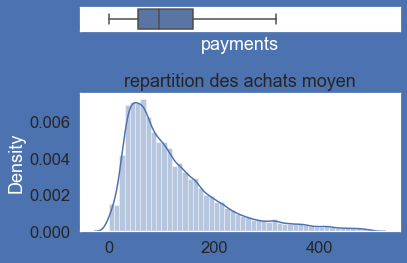

In [15]:
import matplotlib.pyplot as plt
import seaborn as sns
values = payments[(payments['payment_value'] < 500)]['payment_value'].values
df_tmp = pd.DataFrame(values, columns=['Values'])
sns.set(font_scale=1.5, rc={
  "axes.facecolor": "white",
  "figure.facecolor": "b",
  "axes.labelcolor": "white"
})
f, (ax_box, ax_hist) = plt.subplots(2,
                                    sharex=True,
                                    gridspec_kw={"height_ratios": (.15, .85)})
sns.boxplot(data=df_tmp, x="Values", ax=ax_box, color='b', showfliers=False)
sns.distplot(df_tmp)
plt.title('repartition des achats moyen')
ax_box.set(xlabel='payments')
plt.tight_layout()
plt.show()

La valeur mediane des paiements est de 100

In [16]:
payments.payment_type.value_counts()

credit_card    76795
boleto         19784
voucher         5775
debit_card      1529
not_defined        3
Name: payment_type, dtype: int64

In [17]:
payments = payments[~(payments['payment_type'] == 'not_defined')]

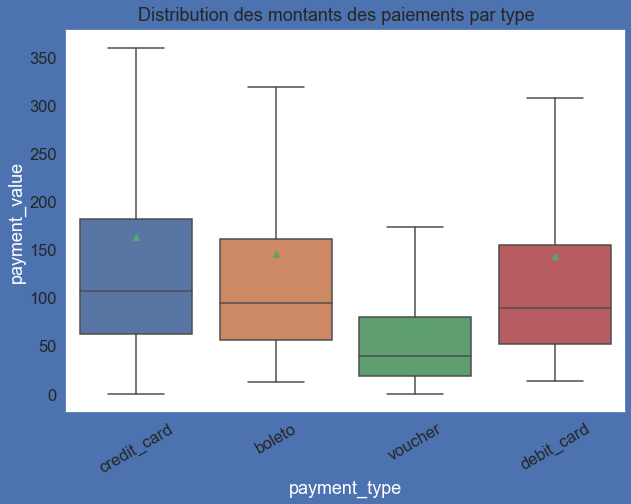

In [18]:
fig = plt.figure(figsize=(10, 7))
col = ['payment_value']
for i in range(len(col)):
    fig.add_subplot(1, 1, i+1)
    c = col[i]
    ax = sns.boxplot(x="payment_type",
                     y=c, data=payments,
                     showfliers=False,
                     showmeans=True)
    for tick in ax.get_xticklabels():
        tick.set_rotation(30)

fig.text(0.5,
         0.90,
         r"Distribution des montants des paiements par type", ha="center")
plt.show()

<AxesSubplot:ylabel='payment_type'>

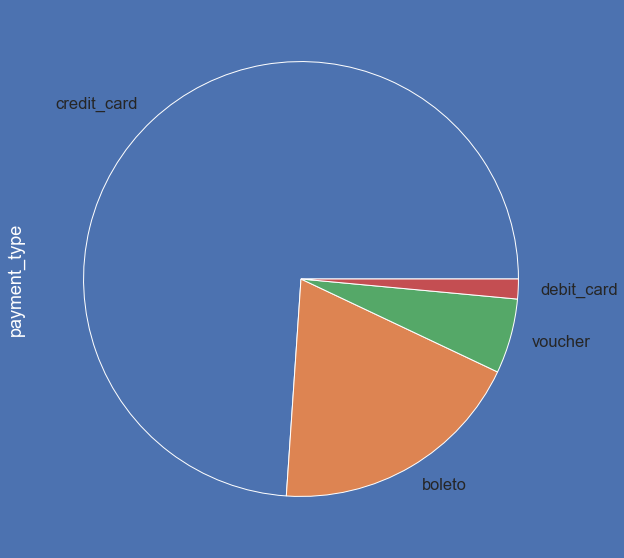

In [19]:
fig = plt.figure(figsize=(10, 10))
payments.payment_type.value_counts().plot.pie()

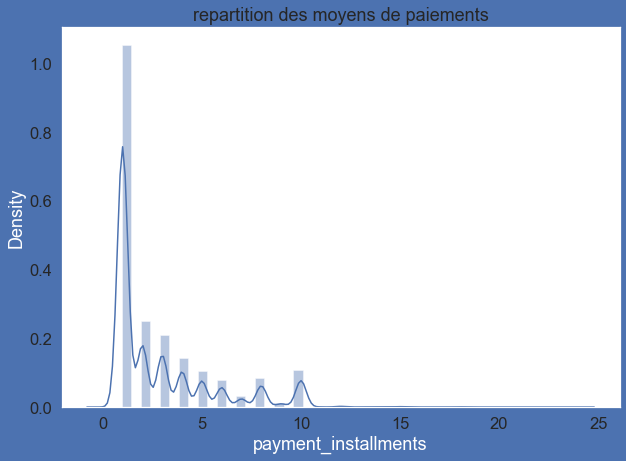

In [20]:
fig = plt.figure(figsize=(10, 7))
sns.distplot(payments.payment_installments)
plt.title('repartition des moyens de paiements')
plt.show()

**Le nombre nombre de paiement moyen est majoritairement de 1**

In [21]:
payments.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 103883 entries, 0 to 103885
Data columns (total 5 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   order_id              103883 non-null  object 
 1   payment_sequential    103883 non-null  int64  
 2   payment_type          103883 non-null  object 
 3   payment_installments  103883 non-null  int64  
 4   payment_value         103883 non-null  float64
dtypes: float64(1), int64(2), object(2)
memory usage: 4.8+ MB


In [22]:
payments = payments.groupby('order_id')['payment_sequential',
                                        'payment_installments',
                                        'payment_value'].sum()

In [23]:
payments.loc[payments.payment_sequential > 0.5].sort_values(
    'payment_sequential', ascending=False)[:10]

,payment_sequential,payment_installments,payment_value
order_id,,,
fa65dad1b0e818e3ccc5cb0e39231352,435,29,457.99
ccf804e764ed5650cd8759557269dc13,351,26,62.68
285c2e15bebd4ac83635ccc563dc71f4,253,22,40.85
895ab968e7bb0d5659d16cd74cd1650c,231,21,161.32
ee9ca989fc93ba09a6eddc250ce01742,190,19,82.73
fedcd9f7ccdc8cba3a18defedd1a5547,190,19,205.74
21577126c19bf11a0b91592e5844ba78,120,15,86.99
4bfcba9e084f46c8e3cb49b0fa6e6159,120,15,740.76
4689b1816de42507a7d63a4617383c59,105,14,529.55


In [24]:
payments.columns = [
                    'payment_sequential_nb',
                    'payment_instlmt_order_nb',
                    'total_payment_value']

In [25]:
payments.loc[payments.payment_sequential_nb > 1].sort_values(
    'payment_sequential_nb', ascending=False)[:10]

,payment_sequential_nb,payment_instlmt_order_nb,total_payment_value
order_id,,,
fa65dad1b0e818e3ccc5cb0e39231352,435,29,457.99
ccf804e764ed5650cd8759557269dc13,351,26,62.68
285c2e15bebd4ac83635ccc563dc71f4,253,22,40.85
895ab968e7bb0d5659d16cd74cd1650c,231,21,161.32
ee9ca989fc93ba09a6eddc250ce01742,190,19,82.73
fedcd9f7ccdc8cba3a18defedd1a5547,190,19,205.74
21577126c19bf11a0b91592e5844ba78,120,15,86.99
4bfcba9e084f46c8e3cb49b0fa6e6159,120,15,740.76
4689b1816de42507a7d63a4617383c59,105,14,529.55


<a name='co'></a>
<div class="bg-primary text-lg-left text-white">
    <div >
        <h1 class="text-center" style="padding: 10px 0 10px 0;">
            Données sur les commandes 
        </h1>
    </div>
</div>

In [26]:
items.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112650 entries, 0 to 112649
Data columns (total 7 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   order_id             112650 non-null  object 
 1   order_item_id        112650 non-null  int64  
 2   product_id           112650 non-null  object 
 3   seller_id            112650 non-null  object 
 4   shipping_limit_date  112650 non-null  object 
 5   price                112650 non-null  float64
 6   freight_value        112650 non-null  float64
dtypes: float64(2), int64(1), object(4)
memory usage: 6.0+ MB


Variables  du dataset regroupant les commandes :

**order_id**: Identifiant unique de la commande

**order_item_id** : Identifiant séquentiel des items d'une même commande (lignes de commande)

**product_id**: Identifiant unique du produit

**seller_id** : Identifiant unique du vendeur

**price** : Prix de la ligne de commande

**freight_value** : Coût de fret de la ligne (Si plusieurs lignes, le coût de fret est réparti entre toutes les lignes)

In [27]:
items[items.order_id == '8272b63d03f5f79c56e9e4120aec44ef']

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
57297,8272b63d03f5f79c56e9e4120aec44ef,1,270516a3f41dc035aa87d220228f844c,2709af9587499e95e803a6498a5a56e9,2017-07-21 18:25:23,1.2,7.89
57298,8272b63d03f5f79c56e9e4120aec44ef,2,05b515fdc76e888aada3c6d66c201dff,2709af9587499e95e803a6498a5a56e9,2017-07-21 18:25:23,1.2,7.89
57299,8272b63d03f5f79c56e9e4120aec44ef,3,05b515fdc76e888aada3c6d66c201dff,2709af9587499e95e803a6498a5a56e9,2017-07-21 18:25:23,1.2,7.89
57300,8272b63d03f5f79c56e9e4120aec44ef,4,05b515fdc76e888aada3c6d66c201dff,2709af9587499e95e803a6498a5a56e9,2017-07-21 18:25:23,1.2,7.89
57301,8272b63d03f5f79c56e9e4120aec44ef,5,05b515fdc76e888aada3c6d66c201dff,2709af9587499e95e803a6498a5a56e9,2017-07-21 18:25:23,1.2,7.89
57302,8272b63d03f5f79c56e9e4120aec44ef,6,05b515fdc76e888aada3c6d66c201dff,2709af9587499e95e803a6498a5a56e9,2017-07-21 18:25:23,1.2,7.89
57303,8272b63d03f5f79c56e9e4120aec44ef,7,05b515fdc76e888aada3c6d66c201dff,2709af9587499e95e803a6498a5a56e9,2017-07-21 18:25:23,1.2,7.89
57304,8272b63d03f5f79c56e9e4120aec44ef,8,05b515fdc76e888aada3c6d66c201dff,2709af9587499e95e803a6498a5a56e9,2017-07-21 18:25:23,1.2,7.89
57305,8272b63d03f5f79c56e9e4120aec44ef,9,05b515fdc76e888aada3c6d66c201dff,2709af9587499e95e803a6498a5a56e9,2017-07-21 18:25:23,1.2,7.89
57306,8272b63d03f5f79c56e9e4120aec44ef,10,05b515fdc76e888aada3c6d66c201dff,2709af9587499e95e803a6498a5a56e9,2017-07-21 18:25:23,1.2,7.89


In [28]:
items.shape

(112650, 7)

In [29]:
items.order_id.nunique()

98666

In [30]:
items.describe()

,order_item_id,price,freight_value
count,112650.000000,112650.000000,112650.000000
mean,1.197834,120.653739,19.990320
std,0.705124,183.633928,15.806405
min,1.000000,0.850000,0.000000
25%,1.000000,39.900000,13.080000
50%,1.000000,74.990000,16.260000
75%,1.000000,134.900000,21.150000
max,21.000000,6735.000000,409.680000


- **order_item_id** : est le nombre d'objets dans une même commande

- **freight_value** : est le coût de livraison

- **shipping_limit_date** : correspond à la date d'expédition auprès du transporteur

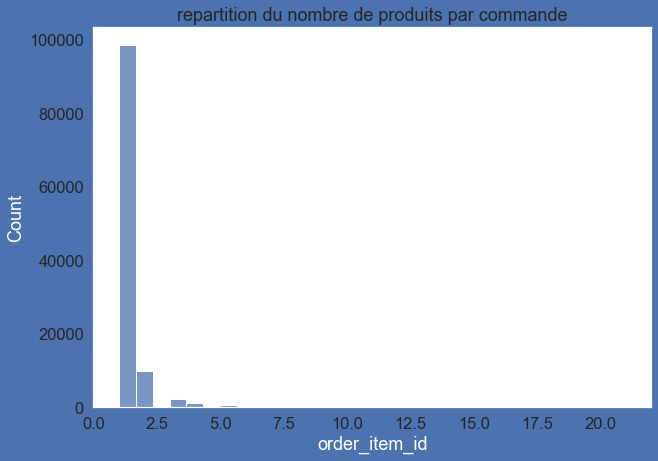

In [31]:
fig = plt.figure(figsize=(10, 7))
sns.histplot(items.order_item_id, bins=30)
plt.title('repartition du nombre de produits par commande')
plt.show()

Les commandes ont majoritairement des commandes a un seul article

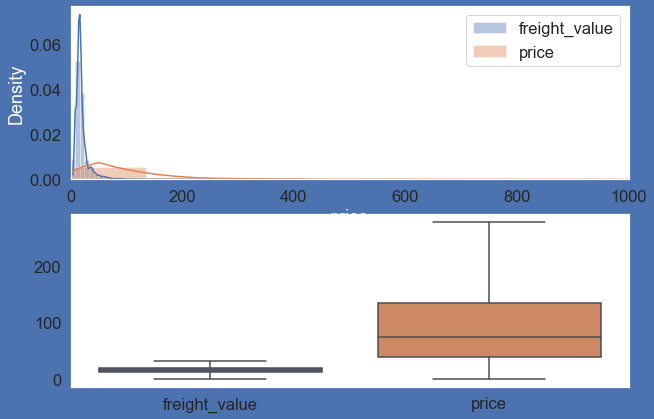

In [32]:
fig = plt.figure(figsize=(10, 7))

# Histogramme freight value et prix
plt.subplot(211)
sns.distplot(items["freight_value"], label="freight_value")
sns.distplot(items["price"], label="price")
plt.legend()
# x-axis limits
plt.xlim([0, 1000])

# Boxplot freight value et prix
plt.subplot(212)
sns.boxplot(data=items, order=["freight_value", "price"], showfliers=False)
plt.show()

In [33]:
items['total_price'] = items["freight_value"] + items["price"]

**Données sur les vendeurs**

In [34]:
sellers.head()

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP


In [35]:
print("nombre de ville :"+str(len(sellers["seller_city"].unique())))
print("nombre d etat :"+str(len(sellers["seller_state"].unique())))

nombre de ville :611
nombre d etat :23


Text(0, 0.5, 'Number ')

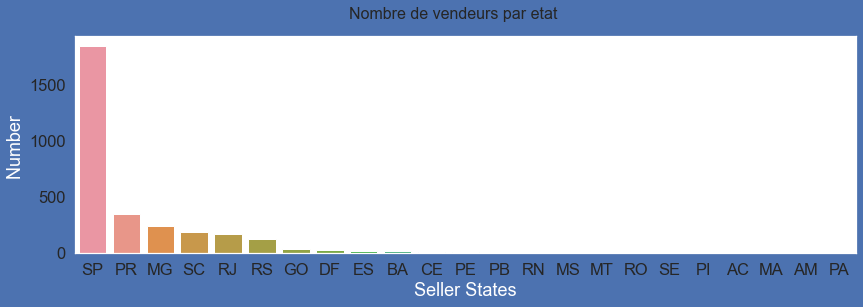

In [36]:
# Affichage graphique du nomnbre de vendeurs dans les différents états
fig = plt.figure(1, figsize=(14, 4))
fig.suptitle("Nombre de vendeurs par etat", fontsize=16)
sns.barplot(y=sellers["seller_state"].value_counts(),
            x=sellers["seller_state"].value_counts().index)
plt.xlabel('Seller States')
plt.ylabel('Number ')

notre etude ce focalise sur les clients , nous n allons pas approndir ce dataset sur les vendeurs

<a name='ci'></a>
<div class="bg-primary text-lg-left text-white">
    <div >
        <h1 class="text-center" style="padding: 10px 0 10px 0;">
            Donnees sur nos Clients
        </h1>
    </div>
</div>

In [37]:
customers.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


Descriptions du  dataset :

**customer_id** : Clé dans le dataset des commandes

**customer_unique_id** : Identifiant unique du client

**customer_state** : Etat du client

In [38]:
customers.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   customer_id               99441 non-null  object
 1   customer_unique_id        99441 non-null  object
 2   customer_zip_code_prefix  99441 non-null  int64 
 3   customer_city             99441 non-null  object
 4   customer_state            99441 non-null  object
dtypes: int64(1), object(4)
memory usage: 3.8+ MB


In [39]:
customers.describe()

,customer_zip_code_prefix
count,99441.000000
mean,35137.474583
std,29797.938996
min,1003.000000
25%,11347.000000
50%,24416.000000
75%,58900.000000
max,99990.000000


In [40]:
print("nombre de villes client :" +
      str(len(customers["customer_city"].unique())))
print("nombre de etat client :" +
      str(len(customers["customer_state"].unique())))
print("nombre de client :" +
      str(len(customers["customer_id"].unique())))

nombre de villes client :4119
nombre de etat client :27
nombre de client :99441


Text(0, 0.5, 'Number ')

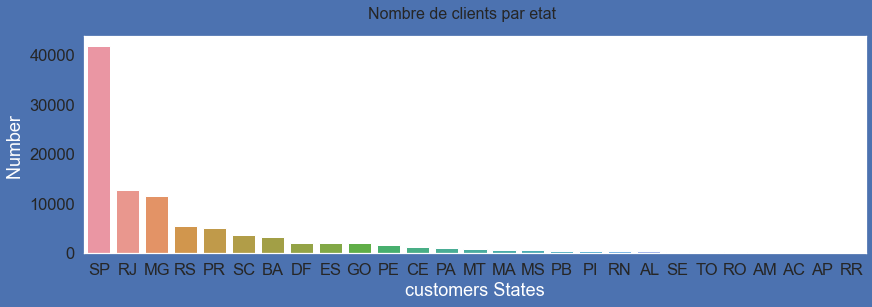

In [41]:
fig = plt.figure(1, figsize=(14, 4))
fig.suptitle("Nombre de clients par etat", fontsize=16)
sns.barplot(y=customers["customer_state"].value_counts(),
            x=customers["customer_state"].value_counts().index)
plt.xlabel('customers States')
plt.ylabel('Number ')

<a name='pr'></a>
<div class="bg-primary text-lg-left text-white">
    <div >
        <h1 class="text-center" style="padding: 10px 0 10px 0;">
            Categorie des  produits 
        </h1>
    </div>
</div>

In [42]:
category.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 71 entries, 0 to 70
Data columns (total 2 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   product_category_name          71 non-null     object
 1   product_category_name_english  71 non-null     object
dtypes: object(2)
memory usage: 1.2+ KB


In [43]:
category.head()

,product_category_name,product_category_name_english
0,beleza_saude,health_beauty
1,informatica_acessorios,computers_accessories
2,automotivo,auto
3,cama_mesa_banho,bed_bath_table
4,moveis_decoracao,furniture_decor


In [44]:
print("nombre de categories :" +
      str(len(category["product_category_name_english"].unique())))

nombre de categories :71


**Feature engineering**

le jeu de données compte plus de 70 catégories différentes (ce qui peut poser problème pour un encodage lors des preprocessing). Nous allons donc devoir regrouper plusieurs de ces catégories en catégorie de niveau supérieur.

In [45]:
category.product_category_name_english.value_counts()

health_beauty                              1
food                                       1
fashion_sport                              1
fashion_underwear_beach                    1
construction_tools_safety                  1
books_general_interest                     1
furniture_bedroom                          1
art                                        1
industry_commerce_and_business             1
computers                                  1
construction_tools_lights                  1
furniture_living_room                      1
musical_instruments                        1
home_construction                          1
books_technical                            1
furniture_mattress_and_upholstery          1
signaling_and_security                     1
christmas_supplies                         1
costruction_tools_tools                    1
small_appliances_home_oven_and_coffee      1
fashion_childrens_clothes                  1
diapers_and_hygiene                        1
arts_and_c

Nous aurons eventuellement besoins de faire de la discretisation de variables pour cette categorie

Les catégories traduites et les produits sont liés par la variable product_category_name. 

In [46]:
# %debug
def renameCategorieType(value):
    f = False
    for key in dictionnary:
        for val in dictionnary[key]:
            if(value.find(val) != -1):
                value = key
                f = True
    if(f is False):
        value = 'other'
    return value


dictionnary = {
    'fashion_clothing_accessories': ['fashio', 'luggage'],
    'health_beauty': ['health', 'beauty', 'perfum', 'health_beauty'],
    'toys_baby': ['toy', 'baby', 'diaper'],
    'books_cds_media': ['book', 'cd', 'dvd', 'media'],
    'groceries_food_drink': ['grocer', 'food', 'drink'],
    'technology': ['phon', 'compu', 'tablet', 'electro', 'consol'],
    'home_furniture': ['home', 'furnitur',
                       'garden', 'bath', 'house', 'applianc'],
    'flowers_gifts': ['flow', 'gift', 'stuff'],
    'sport': ['sports_leisure', 'fashion_sport']
}

category['product_category_name_english'] = category[
    'product_category_name_english'].apply(renameCategorieType)
category['product_category_name_english'].unique()

array(['health_beauty', 'technology', 'other', 'home_furniture', 'sport',
       'flowers_gifts', 'groceries_food_drink', 'toys_baby',
       'fashion_clothing_accessories', 'books_cds_media'], dtype=object)

In [47]:
category['product_category_name_english'].value_counts()

other                           22
home_furniture                  17
fashion_clothing_accessories     8
technology                       7
books_cds_media                  5
flowers_gifts                    3
groceries_food_drink             3
toys_baby                        3
health_beauty                    2
sport                            1
Name: product_category_name_english, dtype: int64

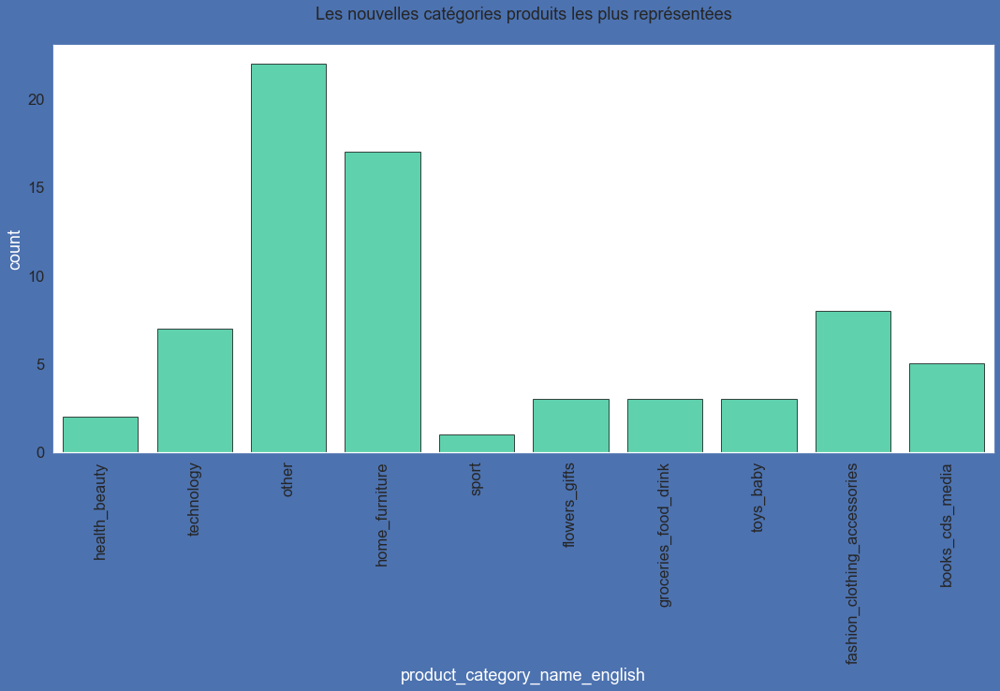

In [48]:
# Plot categories count in dataset
fig = plt.figure(figsize=(18, 8))
sns.countplot(data=category, x="product_category_name_english",
              edgecolor="black",
              color="#00d994", alpha=0.7)
plt.xticks(range(0, category["product_category_name_english"].nunique()),
           category["product_category_name_english"].unique(),
           rotation=90)
plt.title(f"Les nouvelles catégories produits les plus représentées\n")
plt.show()

<a name='ev'></a>

<div class="bg-primary text-lg-left text-white">
    <div >
        <h1 class="text-center" style="padding: 10px 0 10px 0;">
           Evaluation, commentaires
        </h1>
    </div>
</div>

In [49]:
reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99224 entries, 0 to 99223
Data columns (total 7 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   review_id                99224 non-null  object
 1   order_id                 99224 non-null  object
 2   review_score             99224 non-null  int64 
 3   review_comment_title     99224 non-null  object
 4   review_comment_message   99224 non-null  object
 5   review_creation_date     99224 non-null  object
 6   review_answer_timestamp  99224 non-null  object
dtypes: int64(1), object(6)
memory usage: 5.3+ MB


In [50]:
reviews.head()

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,,,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,,,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,,,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,,Parabéns lojas lannister adorei comprar pela Internet seguro e prático Parabéns a todos feliz Páscoa,2018-03-01 00:00:00,2018-03-02 10:26:53


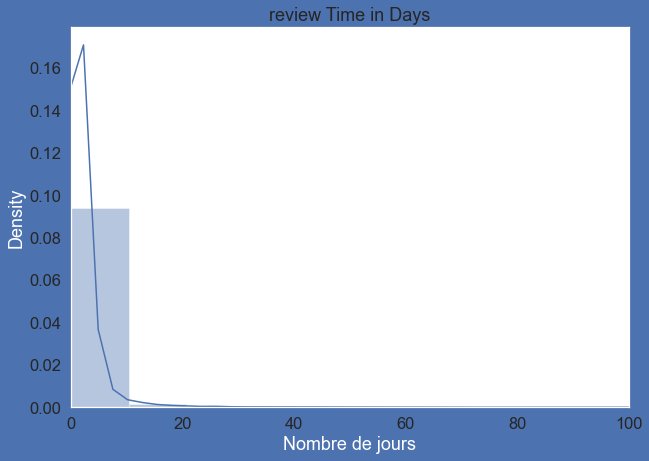

In [51]:
# Histogramme du délai d'évaluation des produits
fig = plt.figure(figsize=(10, 7))
sns.distplot((pd.to_datetime(reviews["review_answer_timestamp"]) -
              pd.to_datetime(reviews["review_creation_date"])).dt.days,
             label="Answer Time")
plt.xlim([0, 100])
plt.xlabel("Nombre de jours")
plt.title("review Time in Days")
plt.show()

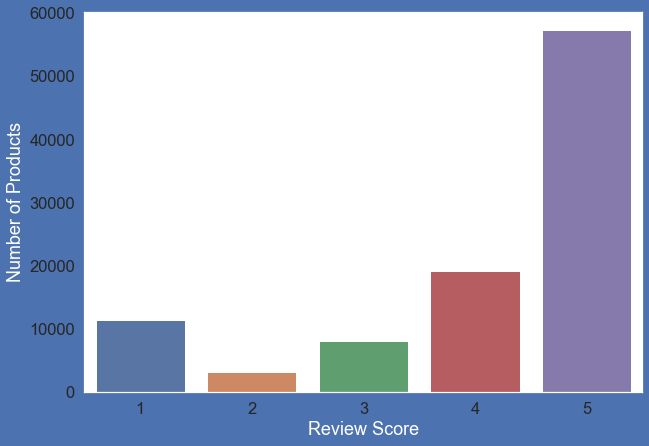

In [52]:
# Nombre de produits pour chaque note
fig = plt.figure(figsize=(10, 7))
review_score = reviews["review_score"].value_counts()
# bar plot du nombre de produits pour chaque note de 1 à 5
sns.barplot(review_score.index, review_score.values)
plt.ylabel("Number of Products")
plt.xlabel("Review Score")
plt.show()

<div class="bg-primary text-lg-left text-white">
    <div >
        <h1 class="text-center" style="padding: 10px 0 10px 0;">
           Données sur les produits
        </h1>
    </div>
</div>

In [53]:
products.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32951 entries, 0 to 32950
Data columns (total 9 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   product_id                  32951 non-null  object 
 1   product_category_name       32951 non-null  object 
 2   product_name_lenght         32951 non-null  float64
 3   product_description_lenght  32951 non-null  float64
 4   product_photos_qty          32951 non-null  float64
 5   product_weight_g            32951 non-null  float64
 6   product_length_cm           32951 non-null  float64
 7   product_height_cm           32951 non-null  float64
 8   product_width_cm            32951 non-null  float64
dtypes: float64(7), object(2)
memory usage: 2.3+ MB


In [54]:
products.head()

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0


In [55]:
products.describe()

,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
count,32951.000000,32951.000000,32951.000000,32951.000000,32951.000000,32951.000000,32951.000000
mean,47.579527,757.213104,2.148463,2276.334315,30.813207,16.936633,23.195320
std,12.071951,637.745057,1.745732,4281.945502,16.915648,13.637779,12.080033
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,41.000000,326.000000,1.000000,300.000000,18.000000,8.000000,15.000000
50%,51.000000,584.000000,1.000000,700.000000,25.000000,13.000000,20.000000
75%,57.000000,961.000000,3.000000,1900.000000,38.000000,21.000000,30.000000
max,76.000000,3992.000000,20.000000,40425.000000,105.000000,105.000000,118.000000


Calcul du volume en cm3

In [56]:
products["product_volume_cm3"] = ((products["product_length_cm"] *
                                  products["product_height_cm"]) /
                                  products["product_width_cm"])

In [57]:
print("nombre de categories par produits:" +
      str(len(products["product_category_name"].unique())))

nombre de categories par produits:74


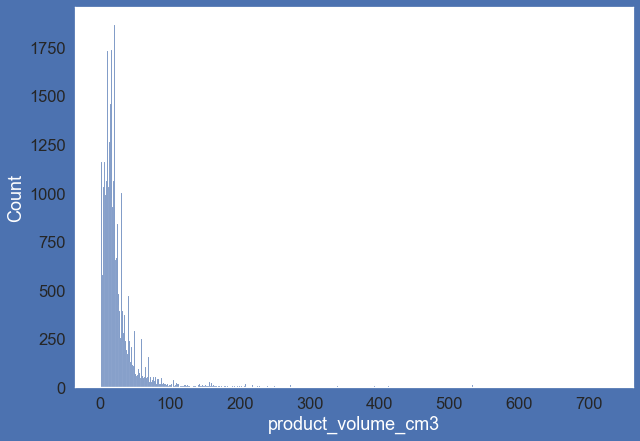

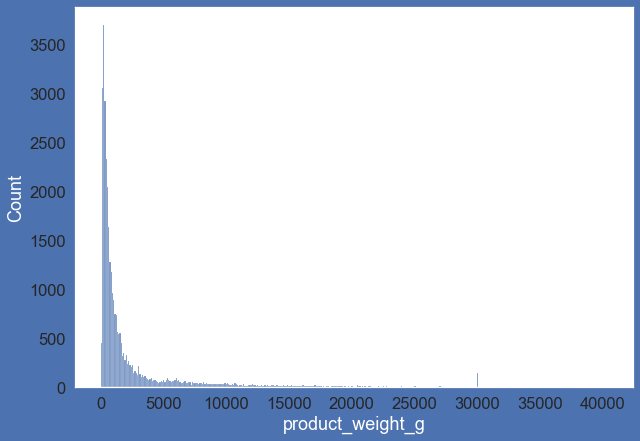

In [58]:
fig = plt.figure(figsize=(10, 7))
sns.histplot(products["product_volume_cm3"])
plt.show()
fig = plt.figure(figsize=(10, 7))
sns.histplot(products["product_weight_g"])
plt.show()

<a name='ac'></a>
<div class="bg-primary text-lg-left text-white">
    <div >
        <h1 class="text-center" style="padding: 10px 0 10px 0;">
           Donnees sur les achats
        </h1>
    </div>
</div>

In [59]:
orders.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   order_id                       99441 non-null  object
 1   customer_id                    99441 non-null  object
 2   order_status                   99441 non-null  object
 3   order_purchase_timestamp       99441 non-null  object
 4   order_approved_at              99281 non-null  object
 5   order_delivered_carrier_date   97658 non-null  object
 6   order_delivered_customer_date  96476 non-null  object
 7   order_estimated_delivery_date  99441 non-null  object
dtypes: object(8)
memory usage: 6.1+ MB


In [60]:
orders.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


In [61]:
orders[orders["customer_id"] == 'b0830fb4747a6c6d20dea0b8c802d7ef']

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00


In [62]:
orders["order_status"].value_counts()

delivered      96478
shipped         1107
canceled         625
unavailable      609
invoiced         314
processing       301
created            5
approved           2
Name: order_status, dtype: int64

Text(0, 0.5, 'Number ')

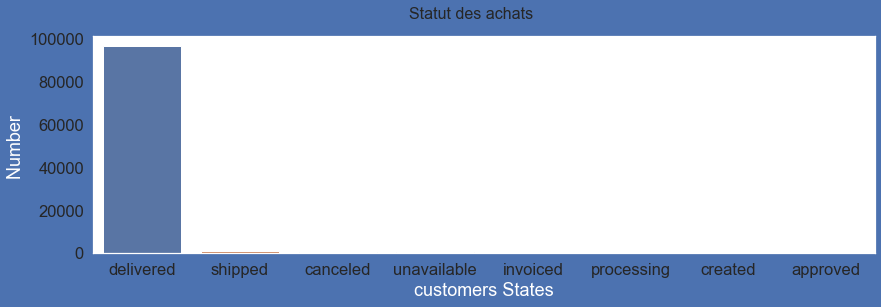

In [63]:
fig = plt.figure(1, figsize=(14, 4))
fig.suptitle("Statut des achats", fontsize=16)
sns.barplot(y=orders["order_status"].value_counts().values,
            x=orders["order_status"].value_counts().index)
plt.xlabel('customers States')
plt.ylabel('Number ')

In [64]:
orders = orders[orders["order_status"] != "canceled"]

In [65]:
from datetime import datetime


def convertToDate(el):
    return pd.to_datetime(el)


def getDays(date):
    return date.days


# Conversion des données dates en datetime
orders['order_approved_at'] = orders['order_approved_at'].apply(convertToDate)
orders['order_estimated_delivery_date'] = orders[
    'order_estimated_delivery_date'].apply(convertToDate)
orders['order_delivered_customer_date'] = orders[
    'order_delivered_customer_date'].apply(convertToDate)
orders['order_purchase_timestamp'] = orders[
    'order_purchase_timestamp'].apply(convertToDate)

orders['delivery_time'] = orders['order_delivered_customer_date'] - \
                          orders['order_approved_at']
orders['delivery_time'] = orders['delivery_time'].apply(getDays)

orders['estimated_delivery_time'] = orders['order_estimated_delivery_date'] - \
                                    orders['order_approved_at']
orders['estimated_delivery_time'] = orders['estimated_delivery_time']\
                                    .apply(getDays)

# nombre de jours écoulés depuis dernier achat
orders['delai_dernier_achat'] = (orders['order_purchase_timestamp'].max() -
                                 orders['order_purchase_timestamp'])
orders['delai_dernier_achat'] = orders['delai_dernier_achat'].apply(getDays)

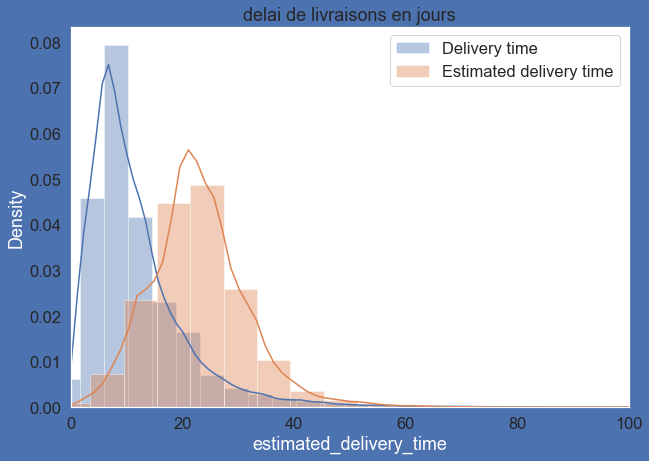

In [66]:
# Delivery estimated time and actual delivery time
fig = plt.figure(figsize=(10, 7))
plt.title("delai de livraisons en jours")
sns.distplot(orders['delivery_time'], label='Delivery time')
sns.distplot(orders['estimated_delivery_time'],
             label='Estimated delivery time')
plt.legend()
plt.xlim([0, 100])
plt.show()

temp estime toutjours superieur au temp de livraison reel

### Discretisation de nos variables

Recuperation des operations d achats sur differentes echelles de temps

In [67]:
# On s'interesse uniquement à l''heure, le jour, et le mois de l'achat
orders.rename(columns={"order_purchase_timestamp":
                       "purchase_time"}, inplace=True)
orders["purchase_time"] = orders["purchase_time"].astype('datetime64[ns]')
orders["purchase_hour"] = orders["purchase_time"].map(lambda d: d.hour)
orders["purchase_weekday"] = orders["purchase_time"].map(lambda d: d.dayofweek)
orders["purchase_month"] = orders["purchase_time"].map(lambda d: d.month)
orders["purchase_day"] = orders["purchase_time"].map(lambda d: d.day)
WE = [5, 6]
orders["purchase_week"] = orders["purchase_day"].isin(WE).astype(np.int)

<a name='mu'></a>

<div class="bg-primary text-lg-left text-white">
    <div >
        <h1 class="text-center" style="padding: 10px 0 10px 0;">
           analyse multivariee
        </h1>
    </div>
</div>

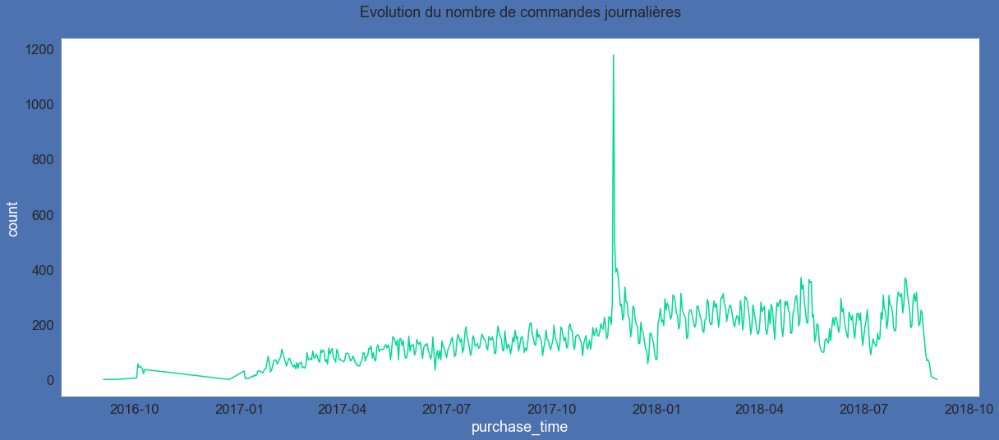

In [68]:
fig = plt.figure(figsize=(20, 8))
orders_per_days = orders.groupby(
    orders["purchase_time"].dt.date).count()["order_id"]
ax = orders_per_days.plot(color="#00d994")
ax.set_ylabel("count")
plt.title(f"Evolution du nombre de commandes journalières\n")
plt.show()

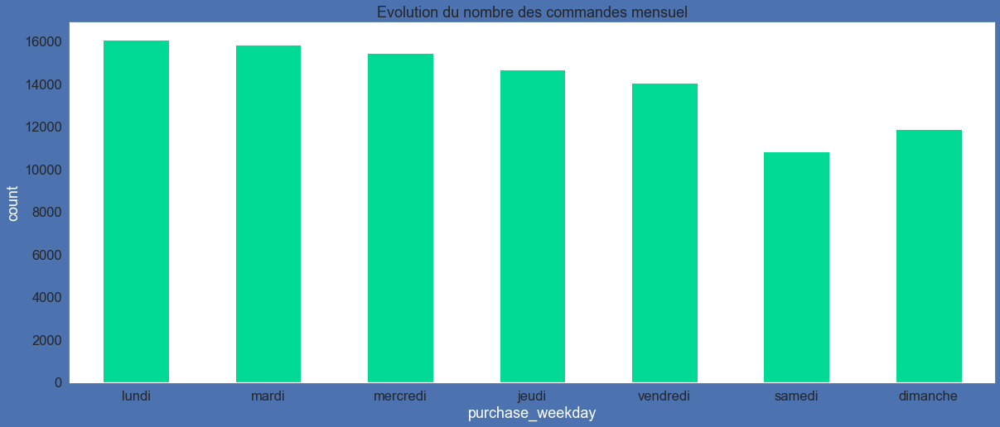

In [69]:
fig = plt.figure(figsize=(20, 8))
orders_per_days = orders.groupby(
    orders["purchase_weekday"]).count()["order_id"]
ax = orders_per_days.plot(color="#00d994", kind='bar')
ax.set_ylabel("count")
plt.title(f"Evolution du nombre des commandes mensuel")
plt.xticks(np.arange(0, 7), ['lundi',
                             'mardi', 'mercredi', 'jeudi',
                             'vendredi', 'samedi',
                             'dimanche'], rotation='horizontal')
plt.show()

Le week-end il y'a moins d'achats effectués que la semaine

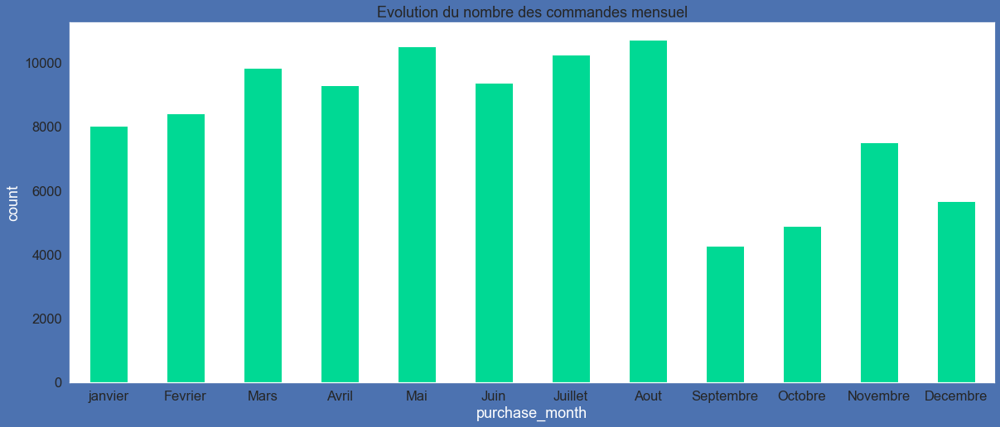

In [70]:
fig = plt.figure(figsize=(20, 8))
orders_per_days = orders.groupby(
    orders["purchase_month"]).count()["order_id"]
ax = orders_per_days.plot(color="#00d994", kind='bar')
ax.set_ylabel("count")
plt.title(f"Evolution du nombre des commandes mensuel")
plt.xticks(np.arange(0, 12), ['janvier',
                              'Fevrier',
                              'Mars', 'Avril', 'Mai', 'Juin', 'Juillet',
                              'Aout', 'Septembre', 'Octobre',
                              'Novembre', 'Decembre'], rotation='horizontal')
plt.show()

Septembre et Octobre sont des périodes creuses

A partir de Novembre, les achats de fin d'année reviennent avec les fêtes

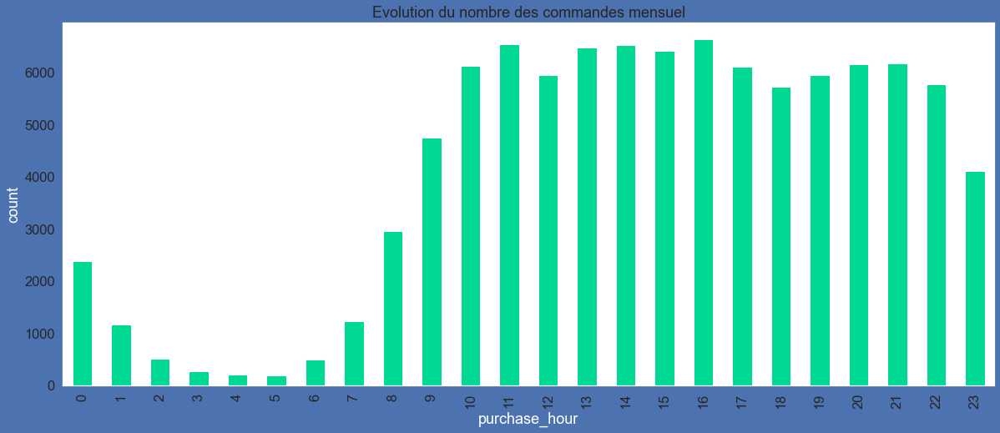

In [71]:
fig = plt.figure(figsize=(20, 8))
orders_per_days = orders.groupby(
    orders["purchase_hour"]).count()["order_id"]
ax = orders_per_days.plot(color="#00d994", kind='bar')
ax.set_ylabel("count")

plt.title(f"Evolution du nombre des commandes mensuel")
plt.show()

In [72]:
payments.columns

Index(['payment_sequential_nb', 'payment_instlmt_order_nb',
       'total_payment_value'],
      dtype='object')

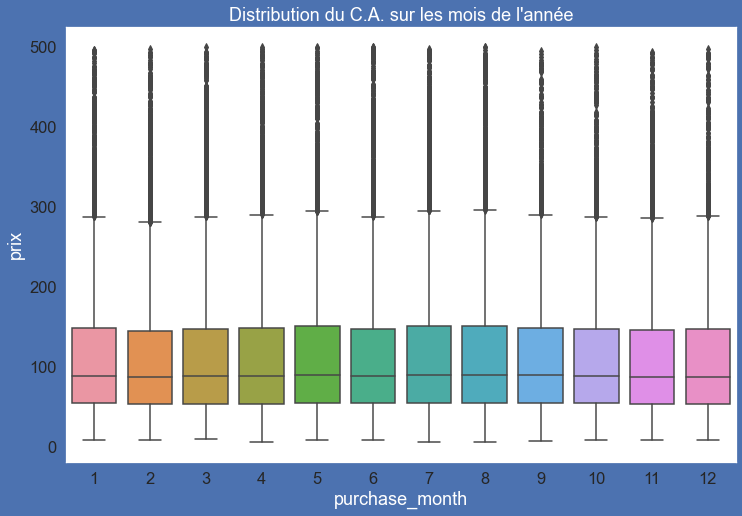

In [73]:
fig = plt.figure(figsize=(12, 8))
sns.boxplot(
    data=items[items.total_price < 500],
    x=orders.purchase_month, y="total_price")
plt.title(
    "Distribution du C.A. sur les mois de l'année", fontsize=18, color="w")
plt.ylabel('prix')
plt.show()

<a name='jo'></a>

<div class="bg-primary text-lg-left text-white">
    <div >
        <h1 class="text-center" style="padding: 10px 0 10px 0;">
           Jointure sur nos données
        </h1>
    </div>
</div>

<img alt="Ridge" width='100%' height='100%' class="img-responsive" src="https://i.imgur.com/HRhd2Y0.png">

Comme nous pouvons le voir la base de donnees recupere respecte une organisation entre elles.
En effet on voit quel les donnees sont organiser afin que les informations ne soit pas redondantes,et respecte une forme normal d une base de donnees relationnel.

On peut voir que nos jointures respecter une relation 1 N entre elles , par exemple un client peut commander des articles plusieurs fois , ou encore que une commande peut contenir plusieurs articles...
Nous allons donc faire une jointure par la gauche entre les dataframe respectant ces relations 1-N pour construire notre dataframe final

Nous allons donc **mettre a plat** notre base de donnee avant de pouvoir travailler sur une seul dataframe

https://fr.wikipedia.org/wiki/Forme_normale_(bases_de_donn%C3%A9es_relationnelles)

In [74]:
customers.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


In [75]:
orders.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 98816 entries, 0 to 99440
Data columns (total 16 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   order_id                       98816 non-null  object        
 1   customer_id                    98816 non-null  object        
 2   order_status                   98816 non-null  object        
 3   purchase_time                  98816 non-null  datetime64[ns]
 4   order_approved_at              98797 non-null  datetime64[ns]
 5   order_delivered_carrier_date   97583 non-null  object        
 6   order_delivered_customer_date  96470 non-null  datetime64[ns]
 7   order_estimated_delivery_date  98816 non-null  datetime64[ns]
 8   delivery_time                  96456 non-null  float64       
 9   estimated_delivery_time        98797 non-null  float64       
 10  delai_dernier_achat            98816 non-null  int64         
 11  purchase_hour  

In [76]:
customers.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   customer_id               99441 non-null  object
 1   customer_unique_id        99441 non-null  object
 2   customer_zip_code_prefix  99441 non-null  int64 
 3   customer_city             99441 non-null  object
 4   customer_state            99441 non-null  object
dtypes: int64(1), object(4)
memory usage: 3.8+ MB


In [77]:
payments.info()

<class 'pandas.core.frame.DataFrame'>
Index: 99437 entries, 00010242fe8c5a6d1ba2dd792cb16214 to fffe41c64501cc87c801fd61db3f6244
Data columns (total 3 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   payment_sequential_nb     99437 non-null  int64  
 1   payment_instlmt_order_nb  99437 non-null  int64  
 2   total_payment_value       99437 non-null  float64
dtypes: float64(1), int64(2)
memory usage: 3.0+ MB


In [78]:
geoloc.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP


In [79]:
geoloc.shape

(738332, 5)

In [80]:
geoloc.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 738332 entries, 0 to 1000161
Data columns (total 5 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   geolocation_zip_code_prefix  738332 non-null  int64  
 1   geolocation_lat              738332 non-null  float64
 2   geolocation_lng              738332 non-null  float64
 3   geolocation_city             738332 non-null  object 
 4   geolocation_state            738332 non-null  object 
dtypes: float64(2), int64(1), object(2)
memory usage: 33.8+ MB


In [81]:
geoloc.drop_duplicates(
    subset=["geolocation_zip_code_prefix"],
    keep="first", inplace=True)

In [82]:
customers = customers.rename(
    columns={
        "customer_zip_code_prefix": "zip_code_prefix"
    })

In [83]:
geoloc = geoloc.rename(
    columns={
        "geolocation_zip_code_prefix": "zip_code_prefix"
    })

Nous allons tenter de calculer les distances des consommateurs par rapport au magasin (haversine distance),
en esperant que cette nouvelle variable va favoriser la segmentation

In [84]:
from math import radians
from numpy import cos, sin, arcsin, sqrt


def haversine(row):
    lon1 = -25.43045
    lat1 = -49.29207
    lon2 = row['geolocation_lat']
    lat2 = row['geolocation_lng']
    lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * arcsin(sqrt(a))
    km = 6367 * c
    return km


geoloc['distance'] = geoloc.apply(lambda row: haversine(row), axis=1)
geoloc.shape

(19015, 6)

In [85]:
geoloc.shape

(19015, 6)

In [86]:
geoloc.sort_values('distance', ascending=True).head()

,zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state,distance
847906,80730,-25.433561,-49.296954,curitiba,PR,0.587661
847911,80710,-25.430846,-49.297630,curitiba,PR,0.618553
845837,80440,-25.441032,-49.296703,curitiba,PR,0.923731
845843,80420,-25.434900,-49.283206,curitiba,PR,1.036452
845383,80370,-25.435891,-49.301322,curitiba,PR,1.101198


In [87]:
geoloc.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 19015 entries, 0 to 999846
Data columns (total 6 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   zip_code_prefix    19015 non-null  int64  
 1   geolocation_lat    19015 non-null  float64
 2   geolocation_lng    19015 non-null  float64
 3   geolocation_city   19015 non-null  object 
 4   geolocation_state  19015 non-null  object 
 5   distance           19015 non-null  float64
dtypes: float64(3), int64(1), object(2)
memory usage: 1.0+ MB


In [88]:
geoloc.shape

(19015, 6)

In [89]:
customers.shape

(99441, 5)

Dans cette partie , nous avons essaye de recupere des informations relatives aux clients sans pour autant avoir trop d informations qui pourrait nuire a la segmentation

In [90]:
customers = pd.merge(customers, geoloc, how="left", on="zip_code_prefix")
products = pd.merge(products, category, how="left", on="product_category_name")

del_features_list = ["product_category_name", "product_weight_g",
                     "product_length_cm", "product_height_cm",
                     "product_width_cm",
                     "product_description_lenght",
                     "product_photos_qty", "product_name_lenght"]
products.drop(del_features_list, axis=1, inplace=True)
products = products.rename(
    columns={
        "product_category_name_english": "product_category_name"
    })

order_items = pd.merge(items, orders, how="left", on="order_id")

del_features_list = ["seller_id", "shipping_limit_date",
                     "order_approved_at", "order_delivered_carrier_date",
                     "order_estimated_delivery_date"]
order_items.drop(del_features_list, axis=1, inplace=True)

order_items_payments = pd.merge(order_items,
                                payments,
                                how="left",
                                on="order_id")
# note moyenne des commentaires
group_reviews = reviews.groupby("order_id").agg({"review_score": "mean"})
order_items_payments = pd.merge(order_items_payments,
                                group_reviews,
                                how="left",
                                on="order_id")
customers_orders = pd.merge(order_items_payments,
                            customers,
                            how="left",
                            on="customer_id")

# Montant moyen des achats
achats_moy = customers_orders.groupby(
    ['customer_id', 'order_id'])['price'].sum().groupby(['customer_id']).mean()
achats_moy.rename('Tot_moy_achats', inplace=True)
print('ok')

# nb produits par commande
products_per_order = customers_orders.groupby(
    ["customer_id", "order_id"]).agg(
    {"order_item_id": "count"})
products_per_order = products_per_order.groupby(
    "customer_id").agg(
    {"order_item_id": "mean"})
products_per_order = products_per_order.rename(
    columns={"order_item_id": "mean_items"})

# order_items = pd.merge(order_items, nb_produits,how="left",on="customer_id")
customers_orders = pd.merge(customers_orders,
                            achats_moy, how="left", on="customer_id")

customers_orders = pd.merge(
    customers_orders,
    products_per_order, how="left", on="customer_id")
data = pd.merge(customers_orders, products, how="left", on="product_id")
print('processing stat ending')

ok
processing stat ending


Toutes les variables en commentaires ci dessous ont etaients retirer car :

- elles sont trop correlees avec d autres variables

- elles cache trop les autres variables lors de la segmentation

In [91]:
# nb_produits = order_items.groupby('customer_id')['product_id'].count()
# nb_produits.rename('Nb_product_total', inplace=True)

# Montant maximum des achats
# achats_max = order_items.groupby(
# ['customer_id', 'order_id'])['price'].max().groupby(
# ['customer_id']).max()
# achats_max.rename('Mont_max_achats',inplace=True)

# Nombre moyen de produits par commande
# nb_moyen_prod = order_items.groupby(
# ['customer_id', 'order_id'])['price'].count().groupby(
# ['customer_id']).mean()
# nb_moyen_prod.rename('Nb_moy_pdts_par_com', inplace=True)

# order_items = pd.merge(order_items, achats_max,how="left",on="customer_id")
# order_items = pd.merge(
# order_items, nb_moyen_prod,how="left",on="customer_id")


# construction d un dataframe avec les achats par category
# categories_customers = data.groupby(
# ["customer_unique_id", "product_category_name"])\
#                         .agg({"order_item_id": "count"}).unstack()
# categories_customers.columns = categories_customers.columns.droplevel(0)
# categories_customers.fillna(0, inplace=True)
# categories_customers["total_items"] = categories_customers.sum(axis=1)

# ratio par category/items
# for col in categories_customers.columns:
#     if (col != "total_items"):
#         categories_customers[col] =
# (categories_customers[col]/categories_customers["total_items"])

# categories_customers.reset_index(inplace=True)
# categories_customers[categories_customers.customer_unique_id
# == '0a0a92112bd4c708ca5fde585afaa872']

In [92]:
data.head()

,order_id,order_item_id,product_id,price,freight_value,total_price,customer_id,order_status,purchase_time,order_delivered_customer_date,delivery_time,estimated_delivery_time,delai_dernier_achat,purchase_hour,purchase_weekday,purchase_month,purchase_day,purchase_week,payment_sequential_nb,payment_instlmt_order_nb,total_payment_value,review_score,customer_unique_id,zip_code_prefix,customer_city,customer_state,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state,distance,Tot_moy_achats,mean_items,product_volume_cm3,product_category_name
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,58.90,13.29,72.19,3ce436f183e68e07877b285a838db11a,delivered,2017-09-13 08:59:02,2017-09-20 23:43:48,7.0,15.0,355.0,8.0,2.0,9.0,13.0,0.0,1.0,2.0,72.19,5.0,871766c5855e863f6eccc05f988b23cb,28013.0,campos dos goytacazes,RJ,-21.758076,-41.312633,campos dos goytacazes,RJ,931.718790,58.90,1.0,18.000000,flowers_gifts
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,239.90,19.93,259.83,f6dd3ec061db4e3987629fe6b26e5cce,delivered,2017-04-26 10:53:06,2017-05-12 16:04:24,16.0,18.0,494.0,10.0,2.0,4.0,26.0,0.0,1.0,3.0,259.83,4.0,eb28e67c4c0b83846050ddfb8a35d051,15775.0,santa fe do sul,SP,-20.212393,-50.941471,santa fe do sul,SP,414.412453,239.90,1.0,37.500000,other
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,199.00,17.87,216.87,6489ae5e4333f3693df5ad4372dab6d3,delivered,2018-01-14 14:33:31,2018-01-22 13:19:16,7.0,21.0,231.0,14.0,6.0,1.0,14.0,0.0,1.0,5.0,216.87,5.0,3818d81c6709e39d06b2738a8d3a2474,35661.0,para de minas,MG,-19.860439,-44.597972,pará de minas,MG,670.929679,199.00,1.0,13.000000,home_furniture
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,12.99,12.79,25.78,d4eb9395c8c0431ee92fce09860c5a06,delivered,2018-08-08 10:00:35,2018-08-14 13:32:39,6.0,11.0,25.0,10.0,2.0,8.0,8.0,0.0,1.0,2.0,25.78,4.0,af861d436cfc08b2c2ddefd0ba074622,12952.0,atibaia,SP,-23.144923,-46.539830,atibaia,SP,349.981823,12.99,1.0,10.666667,health_beauty
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,199.90,18.14,218.04,58dbd0b2d70206bf40e62cd34e84d795,delivered,2017-02-04 13:57:51,2017-03-01 16:42:31,25.0,40.0,575.0,13.0,5.0,2.0,4.0,0.0,1.0,3.0,218.04,5.0,64b576fb70d441e8f1b2d7d446e483c5,13226.0,varzea paulista,SP,-23.249008,-46.824961,varzea paulista,SP,318.422243,199.90,1.0,46.666667,home_furniture


aggregation de notre dataset sur <code>customer_unique_id</code>

In [93]:
customersStat = data.groupby("customer_unique_id").agg(
    {
        "order_id": "nunique",
        "freight_value": "sum",
        "payment_sequential_nb": "mean",
        "payment_instlmt_order_nb": "mean",
        "review_score": "mean",
        "delai_dernier_achat": "min",
        "delivery_time": "mean",
        "Tot_moy_achats": "mean",
        "mean_items": "mean",
        "purchase_month": lambda x: x.value_counts().index[0],
        "customer_state": "min",
        "distance": "max"
        # "price": "sum",
        # "total_price": "sum",
        # "ratio_credit_card_type_nb": "sum",
        # "ratio_boleto_type_nb": "sum",
        # "ratio_voucher_type_nb": "sum",
        # "ratio_debit_card_type_nb": "sum",
        # "nb_payment_type": "sum",
        # "Mont_max_achats":'max',
        # "total_payment_value": lambda x:x.values[0],
        # "Nb_moy_pdts_par_com":'mean',
        # "Note_Moy_Com":'mean',
        # "Nb_product_total":'mean',
        # "purchase_day": lambda x:x.value_counts().index[0],
        # "product_volume_cm3": 'sum',
        # "Recency":"max",
        # "Frequency":"max",
        # "Monetary":"max"
    }
)

customersStat = customersStat.rename(columns={
    "order_id": "nb_orders",
    "freight_value": "total_freight",
    "payment_sequential_nb": "mean_payment_sequential",
    "payment_instlmt_order_nb": "mean_payment_installments",
    "review_score": "mean_review_score",
    "delai_dernier_achat": "delai_dernier_achat_mean",
    "delivery_time": "delai_livraison",
    "purchase_month": "favorite_sale_month",
    "purchase_day": "favorite_sale_day",
    "Nb_product_total": "mean_nb_product_total"
})


# customersStat = pd.merge(
#     customersStat,
#     categories_customers,
#     how="left",
#     on="customer_unique_id")
# data2.reset_index(inplace=True)
customersStat.reset_index(inplace=True)
customersStat.head()

,customer_unique_id,nb_orders,total_freight,mean_payment_sequential,mean_payment_installments,mean_review_score,delai_dernier_achat_mean,delai_livraison,Tot_moy_achats,mean_items,favorite_sale_month,customer_state,distance
0,0000366f3b9a7992bf8c76cfdf3221e2,1,12.00,1.0,8.0,5.0,115.0,6.0,129.90,1.0,5.0,SP,314.852062
1,0000b849f77a49e4a4ce2b2a4ca5be3f,1,8.29,1.0,1.0,4.0,118.0,2.0,18.90,1.0,5.0,SP,310.272915
2,0000f46a3911fa3c0805444483337064,1,17.22,1.0,8.0,3.0,541.0,25.0,69.00,1.0,3.0,SC,171.050688
3,0000f6ccb0745a6a4b88665a16c9f078,1,17.63,1.0,4.0,4.0,325.0,20.0,25.99,1.0,10.0,PA,1757.183820
4,0004aac84e0df4da2b147fca70cf8255,1,16.89,1.0,6.0,5.0,292.0,13.0,180.00,1.0,11.0,SP,247.732286


In [94]:
customersStat[customersStat.customer_unique_id ==
              '083ca1aa470c280236380973a48f77c6']

,customer_unique_id,nb_orders,total_freight,mean_payment_sequential,mean_payment_installments,mean_review_score,delai_dernier_achat_mean,delai_livraison,Tot_moy_achats,mean_items,favorite_sale_month,customer_state,distance
3095,083ca1aa470c280236380973a48f77c6,4,101.38,1.0,5.25,5.0,20.0,9.0,54.72,1.0,8.0,PB,2191.639886


In [95]:
data[data.customer_unique_id ==
     '083ca1aa470c280236380973a48f77c6']

,order_id,order_item_id,product_id,price,freight_value,total_price,customer_id,order_status,purchase_time,order_delivered_customer_date,delivery_time,estimated_delivery_time,delai_dernier_achat,purchase_hour,purchase_weekday,purchase_month,purchase_day,purchase_week,payment_sequential_nb,payment_instlmt_order_nb,total_payment_value,review_score,customer_unique_id,zip_code_prefix,customer_city,customer_state,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state,distance,Tot_moy_achats,mean_items,product_volume_cm3,product_category_name
65264,95287574a39117622fd74f06cadf5eae,1,f731f8587d4088c174397e010cf892a9,56.99,21.20,78.19,9d763d8a54fb8bb371f06d0ec3d9a7de,delivered,2017-08-05 08:25:09,2017-08-18 19:03:51,13.0,39.0,394.0,8.0,5.0,8.0,5.0,1.0,1.0,7.0,78.19,5.0,083ca1aa470c280236380973a48f77c6,58051.0,joao pessoa,PB,-7.152091,-34.838202,joao pessoa,PB,2191.639886,56.99,1.0,13.588235,health_beauty
66006,96dad13c399dce9663d3bd03e84cea2b,1,2835bf7dc6f51f7dcd51d2ca3ab60ce9,59.99,35.74,95.73,c5f246d8cb17193ef5b0e617c0f4a822,delivered,2017-08-16 05:43:05,2017-08-24 18:22:49,8.0,41.0,383.0,5.0,2.0,8.0,16.0,0.0,1.0,9.0,95.73,5.0,083ca1aa470c280236380973a48f77c6,58051.0,joao pessoa,PB,-7.152091,-34.838202,joao pessoa,PB,2191.639886,59.99,1.0,12.800000,home_furniture
75833,acb08a83f62cfd54a98e76c21cd268fd,1,7dcdcf1d40dd5422c3f16685ac1f0dbc,19.90,21.15,41.05,0c972ffe540bb0560f264c58899f5dc1,delivered,2017-07-28 04:06:33,2017-08-03 21:15:55,6.0,31.0,402.0,4.0,4.0,7.0,28.0,0.0,1.0,4.0,41.05,5.0,083ca1aa470c280236380973a48f77c6,58051.0,joao pessoa,PB,-7.152091,-34.838202,joao pessoa,PB,2191.639886,19.90,1.0,3.000000,fashion_clothing_accessories
108959,f79d2206d0301d47bc2a623636ea53d1,1,73326828aa5efe1ba096223de496f596,82.00,23.29,105.29,1309815f779a904c76a5e2398c57792f,shipped,2018-08-13 22:19:59,NaT,NaN,16.0,20.0,22.0,0.0,8.0,13.0,0.0,1.0,1.0,105.29,5.0,083ca1aa470c280236380973a48f77c6,58051.0,joao pessoa,PB,-7.152091,-34.838202,joao pessoa,PB,2191.639886,82.00,1.0,18.750000,groceries_food_drink


In [96]:
customersStat[customersStat.customer_unique_id ==
              '083ca1aa470c280236380973a48f77c6']

,customer_unique_id,nb_orders,total_freight,mean_payment_sequential,mean_payment_installments,mean_review_score,delai_dernier_achat_mean,delai_livraison,Tot_moy_achats,mean_items,favorite_sale_month,customer_state,distance
3095,083ca1aa470c280236380973a48f77c6,4,101.38,1.0,5.25,5.0,20.0,9.0,54.72,1.0,8.0,PB,2191.639886


In [97]:
customersStat[customersStat.nb_orders == 4].head()

,customer_unique_id,nb_orders,total_freight,mean_payment_sequential,mean_payment_installments,mean_review_score,delai_dernier_achat_mean,delai_livraison,Tot_moy_achats,mean_items,favorite_sale_month,customer_state,distance
3095,083ca1aa470c280236380973a48f77c6,4,101.38,1.0,5.250000,5.0,20.0,9.00,54.720000,1.000000,8.0,PB,2191.639886
3359,08e5b38d7948d37fbb2a59fc5e175ab1,4,189.54,1.0,2.000000,4.0,116.0,25.00,216.697500,1.000000,5.0,PB,2193.630582
7045,12d8b5ed661190a3a08183644dfc504d,4,160.11,1.0,4.666667,3.5,123.0,10.50,167.646667,1.666667,3.0,ES,1146.240203
14036,25a560b9a6006157838aab1bdbd68624,4,64.20,1.0,1.000000,4.0,512.0,12.75,16.900000,1.000000,4.0,RS,390.700646
17083,2ddc001b620bd90d0f4378cfde1db887,4,60.98,1.5,1.750000,5.0,151.0,5.50,105.587500,1.000000,11.0,SP,310.963674


In [98]:
customersStat.shape

(94989, 13)

In [99]:
customersStat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 94989 entries, 0 to 94988
Data columns (total 13 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   customer_unique_id         94989 non-null  object 
 1   nb_orders                  94989 non-null  int64  
 2   total_freight              94989 non-null  float64
 3   mean_payment_sequential    94988 non-null  float64
 4   mean_payment_installments  94988 non-null  float64
 5   mean_review_score          94305 non-null  float64
 6   delai_dernier_achat_mean   94989 non-null  float64
 7   delai_livraison            93337 non-null  float64
 8   Tot_moy_achats             94989 non-null  float64
 9   mean_items                 94989 non-null  float64
 10  favorite_sale_month        94989 non-null  float64
 11  customer_state             94989 non-null  object 
 12  distance                   94726 non-null  float64
dtypes: float64(10), int64(1), object(2)
memory usa

<AxesSubplot:>

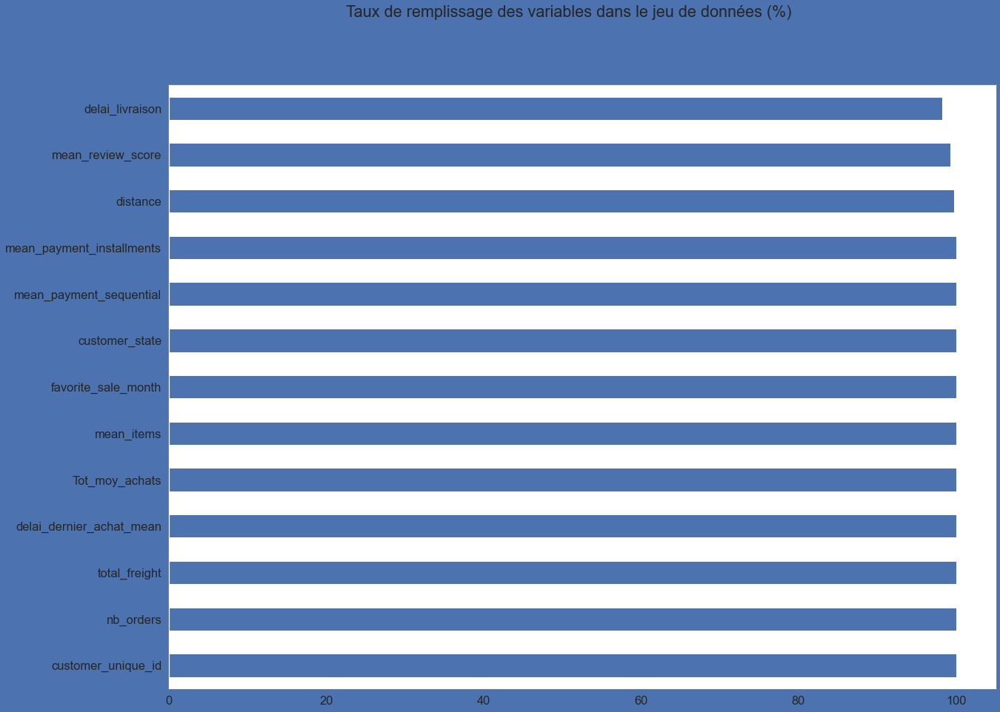

In [100]:
taux = (customersStat.notna().mean(axis=0)*100).sort_values(ascending=False)
plt.suptitle("Taux de remplissage des variables dans le jeu de données (%)")
taux.plot(kind='barh', figsize=(20, 15))

**Nous utilisons un KNN inputer afin de combler les valeurs manquantes de notre dataset**

In [101]:
na_col = customersStat.columns[customersStat.isna().any()].tolist()
customersStat[na_col] = KNNImputer().fit_transform(customersStat[na_col])

In [102]:
customersStat.head()

,customer_unique_id,nb_orders,total_freight,mean_payment_sequential,mean_payment_installments,mean_review_score,delai_dernier_achat_mean,delai_livraison,Tot_moy_achats,mean_items,favorite_sale_month,customer_state,distance
0,0000366f3b9a7992bf8c76cfdf3221e2,1,12.00,1.0,8.0,5.0,115.0,6.0,129.90,1.0,5.0,SP,314.852062
1,0000b849f77a49e4a4ce2b2a4ca5be3f,1,8.29,1.0,1.0,4.0,118.0,2.0,18.90,1.0,5.0,SP,310.272915
2,0000f46a3911fa3c0805444483337064,1,17.22,1.0,8.0,3.0,541.0,25.0,69.00,1.0,3.0,SC,171.050688
3,0000f6ccb0745a6a4b88665a16c9f078,1,17.63,1.0,4.0,4.0,325.0,20.0,25.99,1.0,10.0,PA,1757.183820
4,0004aac84e0df4da2b147fca70cf8255,1,16.89,1.0,6.0,5.0,292.0,13.0,180.00,1.0,11.0,SP,247.732286


<a name='cor'></a>

<div class="bg-primary text-lg-left text-white">
    <div >
        <h1 class="text-center" style="padding: 10px 0 10px 0;">
           Corrélation des variables
        </h1>
    </div>
</div>

In [103]:
df = customersStat
corr = df[df.columns].corr()

Affiche les variables correlees à plus de 50%

In [104]:
corr_pairs = corr.unstack().sort_values(kind="quicksort")
strong_corr = (pd.DataFrame(
    corr_pairs[(abs(corr_pairs) > 0.5)]
).reset_index().rename(columns={
    0: 'coefficient_correllation'
}))
strong_corr = strong_corr[(strong_corr.index % 2 == 0) &
                          (strong_corr['level_0'] != strong_corr['level_1'])]
strong_corr.sort_values('coefficient_correllation', ascending=False)

,level_0,level_1,coefficient_correllation


On remarque que le prix total est très fortement corrélé au prix moyen par commande (idem pour le nombre d'articles moyen et le nombre d'articles total). Cela est dû au fait que la majorité des clients n'ont commandé qu'une seule fois.

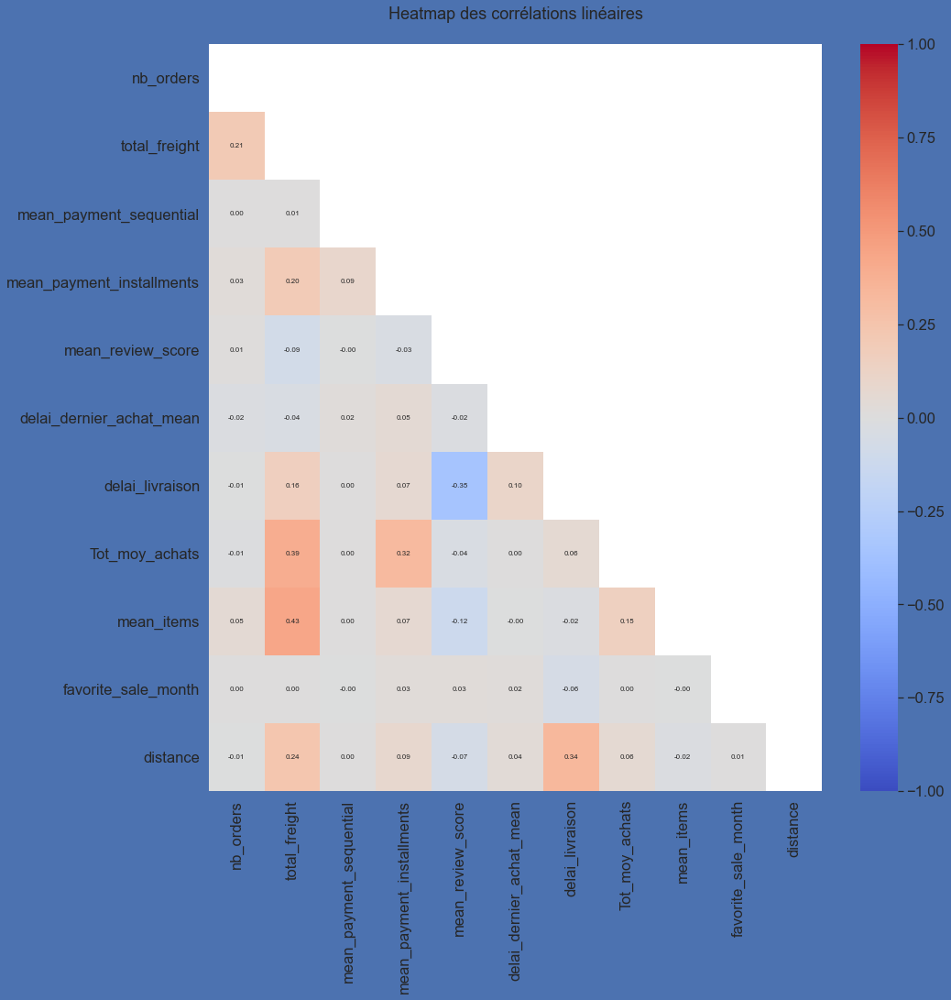

In [105]:
corr = customersStat.corr()
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
fig, ax = plt.subplots(figsize=(15, 15))
ax = sns.heatmap(corr,
                 annot=True,
                 vmin=-1,
                 vmax=1,
                 fmt=".2f",
                 annot_kws={'size': 8},
                 mask=mask,
                 center=0,
                 cmap="coolwarm")
plt.title(f"Heatmap des corrélations linéaires\n")
plt.show()

Nous avons supprimer successivement les variables trop correllees entre elles , afin de genere un dataset se concentrant uniquement sur les donnees clients.

En effet en ajoutant des variables categorielles comme les categories d achat prefere d un client, ou les moyens de paiements par exemple
Lors de la segmentation ces variables vos caches les autres , et les resultats non concluant.
Nous avons donc du simplifier notre dataset afin d ameliorer notre segmentation

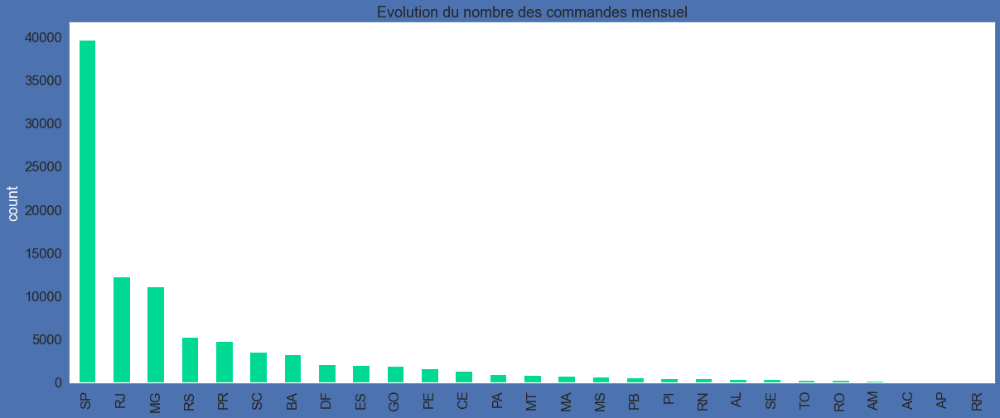

In [106]:
fig = plt.figure(figsize=(20, 8))
orders_per_days = customersStat.customer_state.value_counts()
ax = orders_per_days.plot(color="#00d994", kind='bar')
ax.set_ylabel("count")
plt.title(f"Evolution du nombre des commandes mensuel")
plt.show()

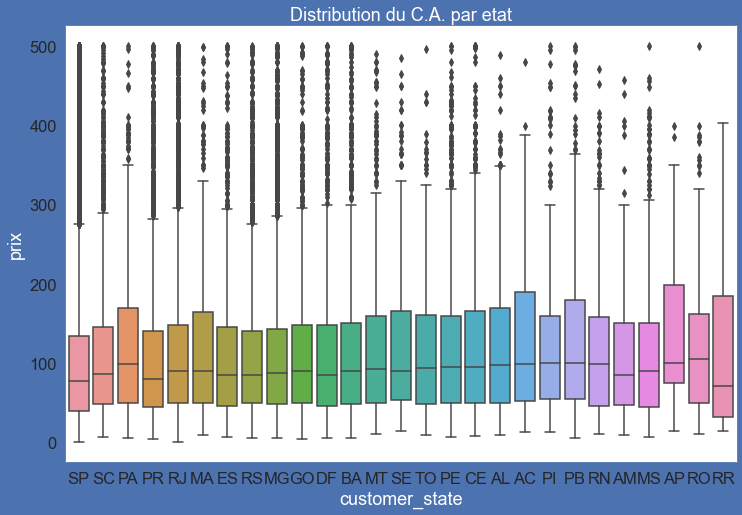

In [107]:
fig = plt.figure(figsize=(12, 8))
sns.boxplot(data=customersStat[customersStat['Tot_moy_achats'] < 500],
            x=df.customer_state,
            y="Tot_moy_achats")
plt.title("Distribution du C.A. par etat", fontsize=18, color="w")
plt.ylabel('prix')
plt.show()

In [108]:
customersStat.drop(["customer_state"], axis=1, inplace=True)

In [109]:
customersStat.to_csv("olist-customers-segmentation.csv")